In [1]:
import torch
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer

from detectron2.data import MetadataCatalog, DatasetCatalog
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

from detectron2.utils.visualizer import Visualizer, ColorMode

torch:  2.0 ; cuda:  cpu


In [16]:
from detectron2.data import DatasetCatalog, MetadataCatalog
if "leaf_all_train" in DatasetCatalog.list():
    DatasetCatalog.remove("leaf_all_train")
    DatasetCatalog.remove("leaf_all_test")

In [2]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode

from detectron2.data import DatasetCatalog, MetadataCatalog
if "leaf_all_train" in DatasetCatalog.list():
    DatasetCatalog.remove("leaf_all_train")
    DatasetCatalog.remove("leaf_all_test")


def get_leaf_dicts(directory):
    classes = ['backgound plant', 'background plant', 'defect', 'leaf']
    dataset_dicts = []
    for idx, filename in enumerate([file for file in os.listdir(directory) if file.endswith('.json')]):
        json_file = os.path.join(directory, filename)
        with open(json_file) as f:
            img_anns = json.load(f)

        record = {}
        name = filename.split('.')
        record["file_name"] = os.path.join(directory, name[0] + '.JPG')
  # Use the JSON file name as the filename
        record["image_id"] = idx
        record["height"] = 4000
        record["width"] = 6000

        annos = img_anns["shapes"]
        objs = []
        for anno in annos:
            px = [a[0] for a in anno['points']]
            py = [a[1] for a in anno['points']]
            poly = [(x, y) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": classes.index(anno['label']),
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts


from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["all_train", "all_test"]:
    DatasetCatalog.register("leaf_" + d, lambda d=d: get_leaf_dicts(r'D:\new env for my tesis/' + d)) #C:\Users\palla/cv/
    MetadataCatalog.get("leaf_" + d).set(thing_classes=['backgound plant', 'background plant', 'defect', 'leaf'])
leaf_metadata = MetadataCatalog.get("leaf_all_train")

In [3]:
dataset_dicts = get_leaf_dicts(r'D:\new env for my tesis/all_train')
for d in dataset_dicts:
    print(d["file_name"])    
dataset_dicts    

D:\new env for my tesis/all_train\DSC00025.JPG
D:\new env for my tesis/all_train\DSC00025_flip.JPG
D:\new env for my tesis/all_train\DSC00025_rotated.JPG
D:\new env for my tesis/all_train\DSC00025_scaled.JPG
D:\new env for my tesis/all_train\DSC00026.JPG
D:\new env for my tesis/all_train\DSC00026_flip.JPG
D:\new env for my tesis/all_train\DSC00026_rotated.JPG
D:\new env for my tesis/all_train\DSC00026_scaled.JPG
D:\new env for my tesis/all_train\DSC00027.JPG
D:\new env for my tesis/all_train\DSC00027_flip.JPG
D:\new env for my tesis/all_train\DSC00027_rotated.JPG
D:\new env for my tesis/all_train\DSC00027_scaled.JPG
D:\new env for my tesis/all_train\DSC00028.JPG
D:\new env for my tesis/all_train\DSC00028_flip.JPG
D:\new env for my tesis/all_train\DSC00028_rotated.JPG
D:\new env for my tesis/all_train\DSC00028_scaled.JPG
D:\new env for my tesis/all_train\DSC00029.JPG
D:\new env for my tesis/all_train\DSC00029_flip.JPG
D:\new env for my tesis/all_train\DSC00029_rotated.JPG
D:\new env for

[{'file_name': 'D:\\new env for my tesis/all_train\\DSC00025.JPG',
  'image_id': 0,
  'height': 4000,
  'width': 6000,
  'annotations': [{'bbox': [0.0,
     961.9047619047619,
     4198.412698412699,
     3998.4126984126983],
    'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[35.416666666666686,
      2883.3333333333335,
      181.25,
      2770.8333333333335,
      285.4166666666667,
      2687.5000000000005,
      364.5833333333333,
      2658.3333333333335,
      456.25000000000006,
      2620.8333333333335,
      502.85714285714283,
      2599.9999999999995,
      537.1428571428571,
      2589.9999999999995,
      592.8571428571428,
      2565.7142857142853,
      621.4285714285713,
      2549.9999999999995,
      655.7142857142857,
      2528.5714285714284,
      688.5714285714286,
      2512.8571428571427,
      718.5714285714286,
      2494.285714285714,
      754.2857142857142,
      2474.285714285714,
      797.1428571428571,
      2445.7142857142853,
      814.2857

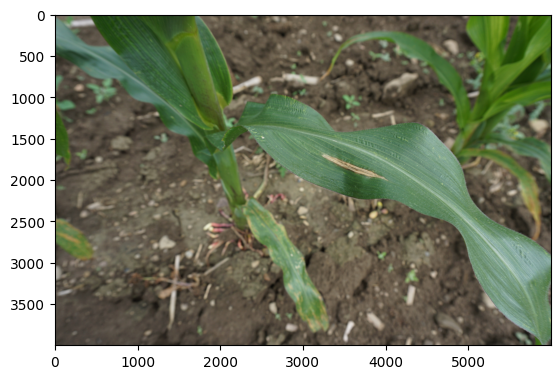

In [4]:
import matplotlib.pyplot as plt
from PIL import Image

# specify the path to the image file
image_path = r'D:\new env for my tesis/all_train/DSC00025_flip.JPG'

# load the image file
image = Image.open(image_path)

# display the image
plt.imshow(image)
plt.show()


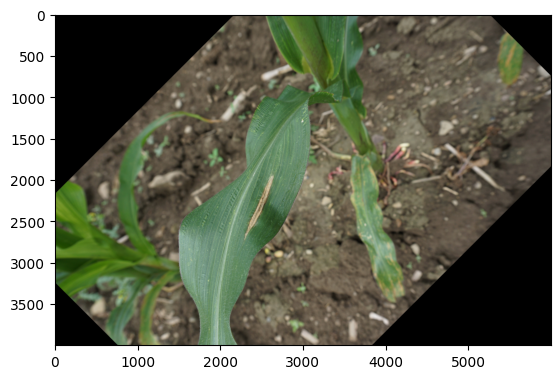

In [5]:
import matplotlib.pyplot as plt
from PIL import Image

# specify the path to the image file
image_path = r'D:\new env for my tesis/all_train/DSC00025_rotated.JPG'

# load the image file
image = Image.open(image_path)

# display the image
plt.imshow(image)
plt.show()


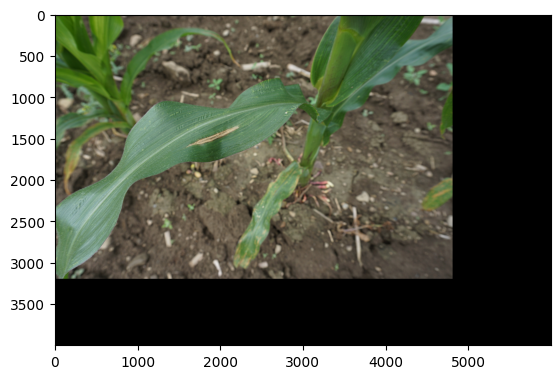

In [6]:
import matplotlib.pyplot as plt
from PIL import Image

# specify the path to the image file
image_path = r'D:\new env for my tesis/all_train/DSC00025_scaled.JPG'

# load the image file
image = Image.open(image_path)

# display the image
plt.imshow(image)
plt.show()


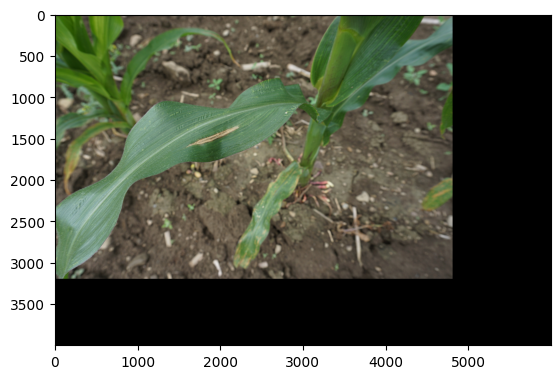

Image size: (6000, 4000)


In [7]:
import matplotlib.pyplot as plt
from PIL import Image

# Specify the path to the image file
image_path = r'D:\new env for my tesis/all_train/DSC00025_scaled.JPG'

# Load the image file
image = Image.open(image_path)

# Display the image
plt.imshow(image)
plt.show()

# Get the size of the image
image_size = image.size
print("Image size:", image_size)


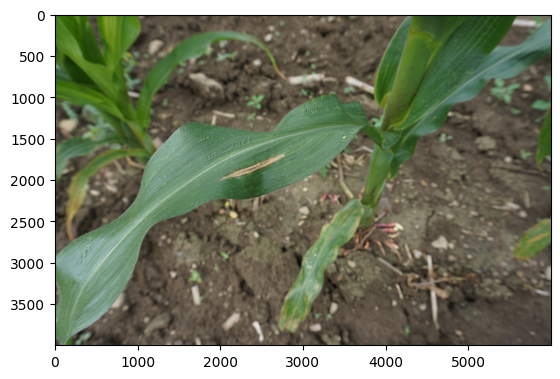

In [8]:
import matplotlib.pyplot as plt
from PIL import Image

# specify the path to the image file
image_path = r'D:\new env for my tesis/all_train/DSC00025.JPG'

# load the image file
image = Image.open(image_path)

# display the image
plt.imshow(image)
plt.show()


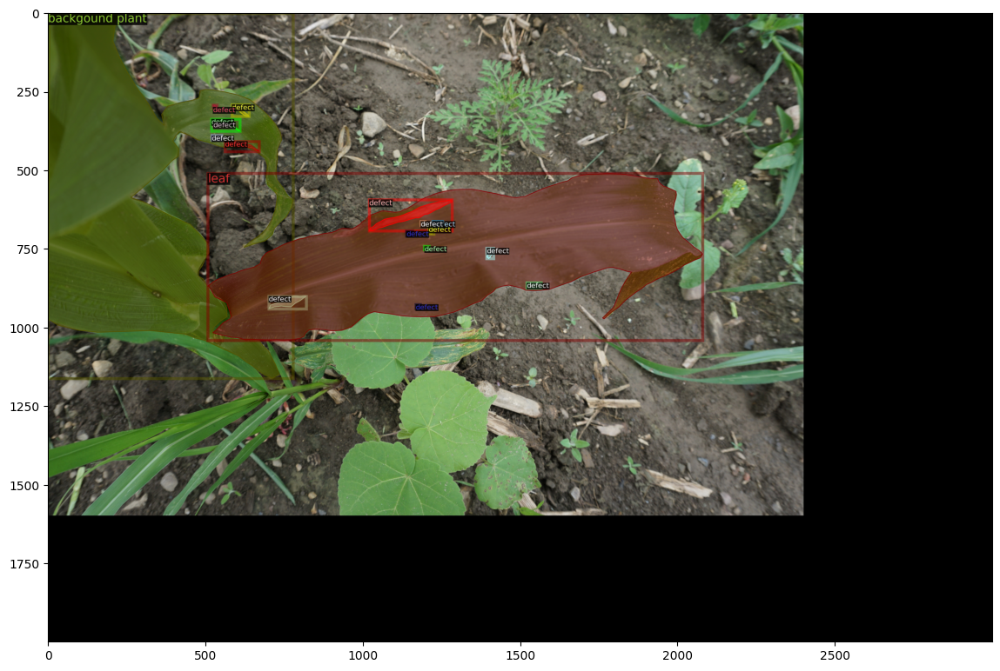

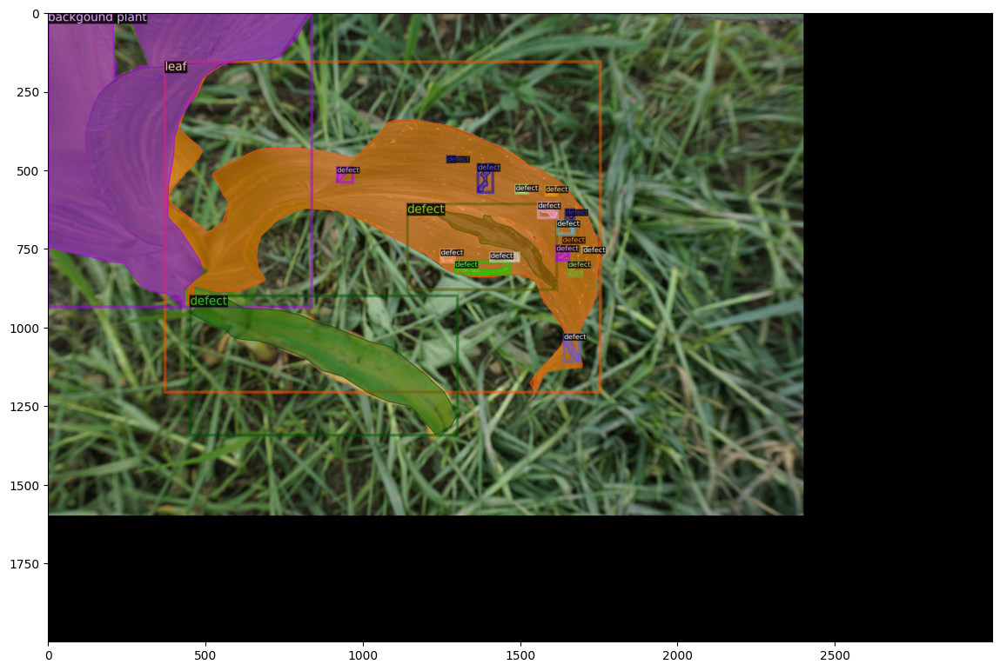

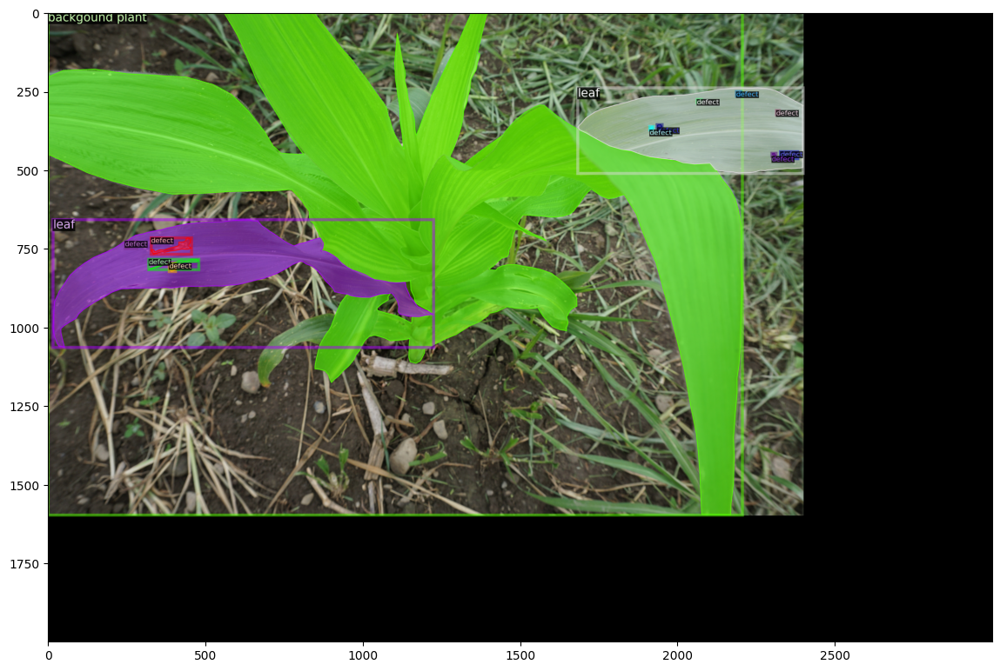

In [9]:
import os
import random

for d in random.sample(dataset_dicts, 3):
    #print(d)
    if not os.path.exists(d["file_name"]):
        print(f"File not found: {d['file_name']}")
        continue

    img = cv2.imread(d["file_name"])
    if img is None:
        print(f"Unable to read image: {d['file_name']}")
        continue
    
    v = Visualizer(img[:, :, ::-1], metadata=leaf_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [10]:

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()

cfg_file_path = r"D:\new env for my tesis/detectron2/configs/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"
#cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.merge_from_file(cfg_file_path)



#print(get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("leaf_all_train")
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
print(cfg.MODEL.WEIGHTS)
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4

https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl


In [12]:
'''os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
#cfg.MODEL.DEVICE = 'cpu'
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()'''

[05/26 16:57:42 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (4, 256, 1, 1) 

[05/26 16:57:43 d2.engine.train_loop]: Starting training from iteration 0
[05/26 16:57:59 d2.utils.events]:  eta: 0:11:53  iter: 19  total_loss: 7.307  loss_cls: 1.662  loss_box_reg: 0.2216  loss_mask: 0.6914  loss_rpn_cls: 4.231  loss_rpn_loc: 0.6686    time: 0.7127  last_time: 0.7051  data_time: 0.4077  last_data_time: 0.4421   lr: 4.9953e-06  max_mem: 3365M
[05/26 16:58:14 d2.utils.events]:  eta: 0:11:52  iter: 39  total_loss: 6.386  loss_cls: 1.481  loss_box_reg: 0.2319  loss_mask: 0.69  loss_rpn_cls: 3.472  loss_rpn_loc: 0.6133    time: 0.7271  last_time: 0.7373  data_time: 0.4407  last_data_time: 0.4510   lr: 9.9902e-06  max_mem: 3366M
[05/26 16:58:29 d2.utils.events]:  eta: 0:11:41  iter: 59  total_loss: 3.622  loss_cls: 1.166  loss_box_reg: 0.1366  loss_mask: 0.6876  loss_rpn_cls: 0.7783  loss_rpn_loc: 0.6594    time: 0.7353  last_time: 0.7663  data_time: 0.4612  last_data_time: 0.4783   lr: 1.4985e-05  max_mem: 3366M
[05/26 16:58:43 d2.utils.events]:  eta: 0:11:26  iter: 79  t

In [ ]:
# # create the trainer object
# trainer = DefaultTrainer(cfg)

# # train the model
# trainer.train()

# # save the trained model
# trainer.save_checkpoint("path/to/checkpoint.pth")

In [11]:
import os
import torch

# Get the current working directory
cwd = os.getcwd()

# Define the file name and path
filename = "model_state_dict_2.pth"
file_path = os.path.join(cwd, filename)

# Save the PyTorch model state dict to the file
torch.save(trainer.model.state_dict(), file_path)

NameError: name 'trainer' is not defined

In [11]:
cfg.MODEL.WEIGHTS =("model_state_dict_2.pth")
cfg.MODEL.DEVICE = 'cpu'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4
cfg.DATASETS.TEST = ("leaf_all_test", )
predictor = DefaultPredictor(cfg)

[07/26 07:56:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from model_state_dict_2.pth ...


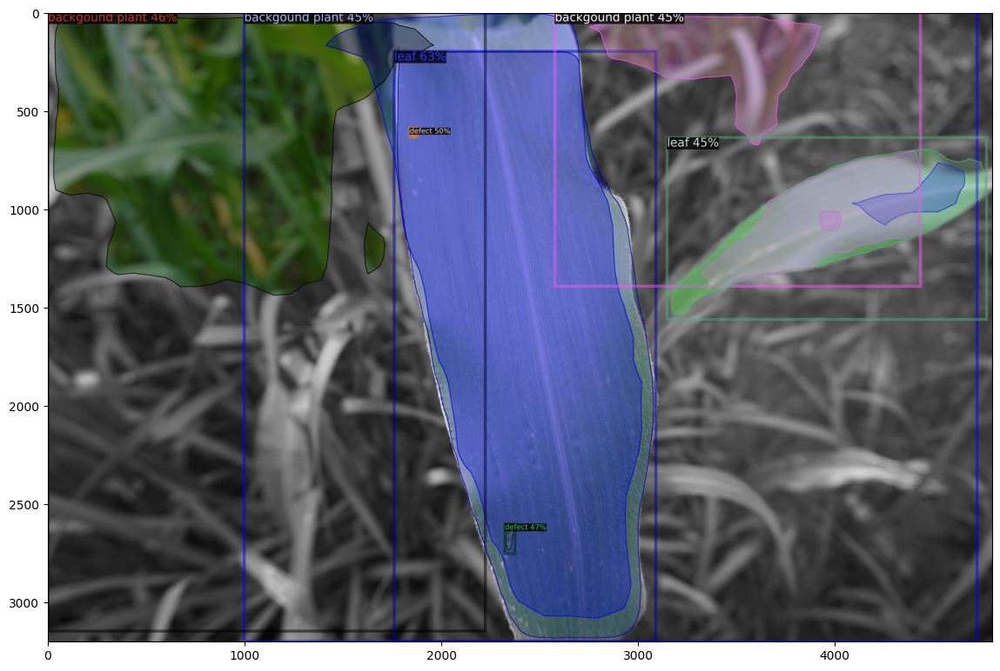

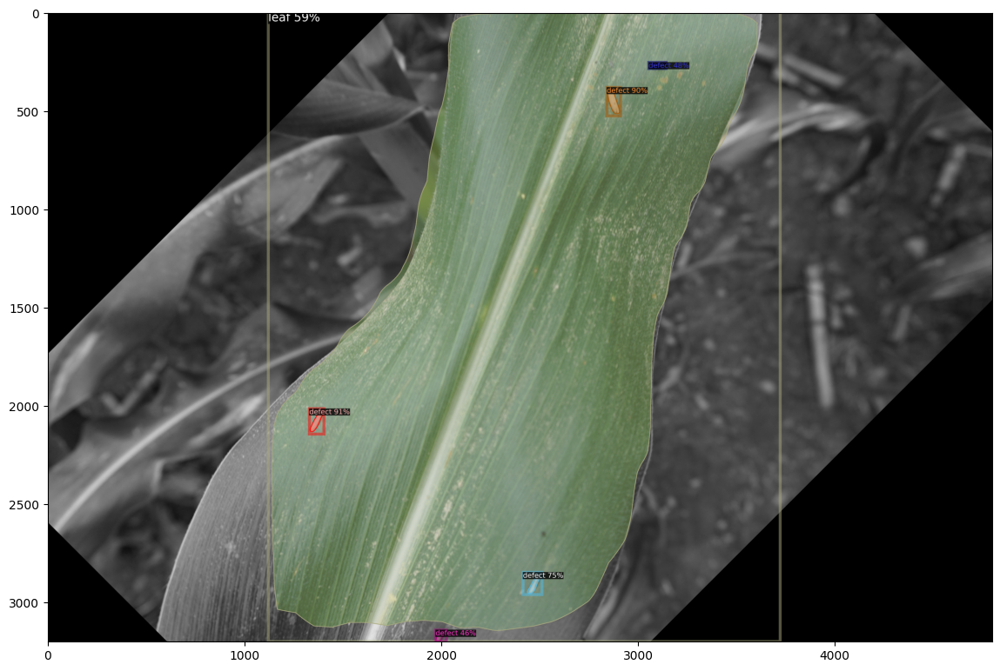

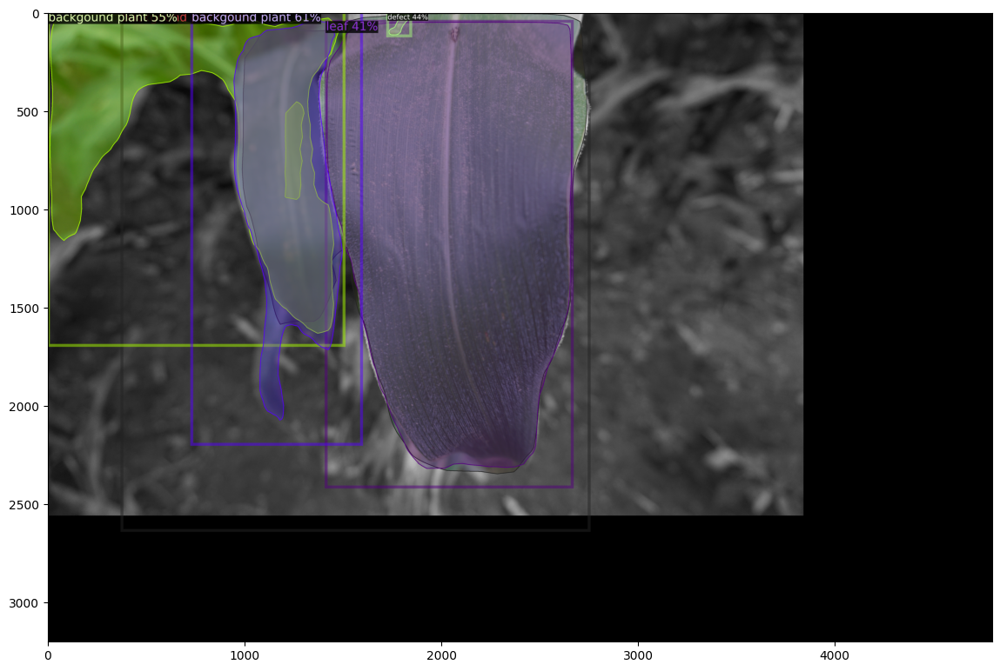

In [12]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts_T = get_leaf_dicts(r'D:\new env for my tesis/all_test')
for dT in random.sample(dataset_dicts_T, 3):    
    im = cv2.imread(dT["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=leaf_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [13]:
from shapely.geometry import Polygon
from shapely.geometry import box as shapely_box

def compute_iou(gt_polygon, pred_polygon):
    gt_polygon = Polygon(gt_polygon)
    pred_polygon = Polygon(pred_polygon)
    intersection_area = gt_polygon.intersection(pred_polygon).area
    union_area = gt_polygon.union(pred_polygon).area
    iou = intersection_area / union_area
    return iou

def evaluate_iou(dataset_dicts, predictor):
    iou_sum = 0
    total_instances = 0

    for d in dataset_dicts:
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)
        pred_instances = outputs["instances"].to("cpu")

        for gt_instance in d["annotations"]:
            gt_polygon = gt_instance["segmentation"][0]
            gt_polygon = [gt_polygon[i:i+2] for i in range(0, len(gt_polygon), 2)]

            iou_max = 0
            pred_masks = pred_instances.pred_masks
            for pred_mask in pred_masks:
                pred_mask = pred_mask.numpy()
                contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                pred_polygon = contours[0].squeeze().tolist()
                iou = compute_iou(gt_polygon, pred_polygon)
                iou_max = max(iou_max, iou)

            iou_sum += iou_max
            total_instances += 1

    mean_iou = iou_sum / total_instances
    return mean_iou

mean_iou_score = evaluate_iou(dataset_dicts_T, predictor)
print("Mean IoU Score:", mean_iou_score)


KeyboardInterrupt: 

In [34]:
from shapely.geometry import Polygon
from shapely.geometry import box as shapely_box

def is_polygon_valid(polygon):
    return polygon.is_valid

def compute_iou(gt_polygon, pred_polygon):
    gt_polygon = Polygon(gt_polygon)
    pred_polygon = Polygon(pred_polygon)

    if not is_polygon_valid(gt_polygon) or not is_polygon_valid(pred_polygon):
        return 0.0  # Invalid polygons, set IoU to 0

    intersection_area = gt_polygon.intersection(pred_polygon).area
    union_area = gt_polygon.union(pred_polygon).area
    iou = intersection_area / union_area
    return iou

def evaluate_iou(dataset_dicts, predictor):
    iou_sum = 0
    total_instances = 0

    for d in dataset_dicts:
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)
        pred_instances = outputs["instances"].to("cpu")

        for gt_instance in d["annotations"]:
            gt_polygon = gt_instance["segmentation"][0]
            gt_polygon = [gt_polygon[i:i+2] for i in range(0, len(gt_polygon), 2)]

            iou_max = 0
            pred_masks = pred_instances.pred_masks
            for pred_mask in pred_masks:
                pred_mask = pred_mask.numpy()
                contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                pred_polygon = contours[0].squeeze().tolist()
                iou = compute_iou(gt_polygon, pred_polygon)
                iou_max = max(iou_max, iou)

            iou_sum += iou_max
            total_instances += 1

    mean_iou = iou_sum / total_instances
    return mean_iou

mean_iou_score = evaluate_iou(dataset_dicts_T, predictor)
print("Mean IoU Score:", mean_iou_score)


Mean IoU Score: 0.29749609639094887


In [14]:
from shapely.geometry import Polygon

def is_polygon_valid(polygon):
    return polygon.is_valid

def compute_iou(gt_polygon, pred_polygon):
    gt_polygon = Polygon(gt_polygon)
    pred_polygon = Polygon(pred_polygon)

    if not is_polygon_valid(gt_polygon) or not is_polygon_valid(pred_polygon):
        return 0.0  # Invalid polygons, set IoU to 0

    intersection_area = gt_polygon.intersection(pred_polygon).area
    union_area = gt_polygon.union(pred_polygon).area
    iou = intersection_area / union_area
    return iou

def evaluate_iou_individual(dataset_dicts, predictor):
    iou_scores = []

    for d in dataset_dicts:
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)
        pred_instances = outputs["instances"].to("cpu")

        for gt_instance in d["annotations"]:
            gt_polygon = gt_instance["segmentation"][0]
            gt_polygon = [gt_polygon[i:i+2] for i in range(0, len(gt_polygon), 2)]

            iou_max = 0
            pred_masks = pred_instances.pred_masks
            for pred_mask in pred_masks:
                pred_mask = pred_mask.numpy()
                contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                pred_polygon = contours[0].squeeze().tolist()
                iou = compute_iou(gt_polygon, pred_polygon)
                iou_max = max(iou_max, iou)

            iou_scores.append(iou_max)

    return iou_scores

individual_iou_scores = evaluate_iou_individual(dataset_dicts_T, predictor)

# Print IoU scores for each image
for idx, iou_score in enumerate(individual_iou_scores):
    print(f"Image {idx + 1} - IoU: {iou_score}")

# Calculate and print mean IoU score for all images
mean_iou_score = sum(individual_iou_scores) / len(individual_iou_scores)
print("Mean IoU Score:", mean_iou_score)


Image 1 - IoU: 0.8500359077143917
Image 2 - IoU: 0.9062788083341011
Image 3 - IoU: 0.5683971819312058
Image 4 - IoU: 0.42079854817490764
Image 5 - IoU: 0.865621559430399
Image 6 - IoU: 0.9009226936873492
Image 7 - IoU: 0.5856363846991701
Image 8 - IoU: 0.3838470382882914
Image 9 - IoU: 0.5534547823006213
Image 10 - IoU: 0.6877211079670059
Image 11 - IoU: 0.5495313860259218
Image 12 - IoU: 0.42887219347932304
Image 13 - IoU: 0.8863037456273493
Image 14 - IoU: 0.9218522531486789
Image 15 - IoU: 0.6003948671382334
Image 16 - IoU: 0.3715771136291157
Image 17 - IoU: 0.7457023469442395
Image 18 - IoU: 0.3272760800199425
Image 19 - IoU: 0.002175191335028738
Image 20 - IoU: 0.7494533609293564
Image 21 - IoU: 0.017309472996729892
Image 22 - IoU: 0
Image 23 - IoU: 0.695691509995045
Image 24 - IoU: 0.26937079206620873
Image 25 - IoU: 0
Image 26 - IoU: 0.7521178792493001
Image 27 - IoU: 0.32994059689222344
Image 28 - IoU: 0.004344835005874133
Image 29 - IoU: 0.13269163320475436
Image 30 - IoU: 0.5

In [15]:
from shapely.geometry import Polygon

def is_polygon_valid(polygon):
    return polygon.is_valid

def compute_iou(gt_polygon, pred_polygon):
    gt_polygon = Polygon(gt_polygon)
    pred_polygon = Polygon(pred_polygon)

    if not is_polygon_valid(gt_polygon) or not is_polygon_valid(pred_polygon):
        return 0.0  # Invalid polygons, set IoU to 0

    intersection_area = gt_polygon.intersection(pred_polygon).area
    union_area = gt_polygon.union(pred_polygon).area
    iou = intersection_area / union_area
    return iou

def evaluate_iou_individual(dataset_dicts, predictor):
    class_iou_scores = {}  # Dictionary to store IoU scores for each class

    for d in dataset_dicts:
        im = cv2.imread(d["file_name"])
        outputs = predictor(im)
        pred_instances = outputs["instances"].to("cpu")

        for gt_instance in d["annotations"]:
            gt_polygon = gt_instance["segmentation"][0]
            gt_polygon = [gt_polygon[i:i+2] for i in range(0, len(gt_polygon), 2)]

            for pred_class in pred_instances.pred_classes:
                pred_class = pred_class.item()

                if pred_class not in class_iou_scores:
                    class_iou_scores[pred_class] = []

                iou_max = 0
                pred_masks = pred_instances.pred_masks
                for pred_mask in pred_masks:
                    pred_mask = pred_mask.numpy()
                    contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                    pred_polygon = contours[0].squeeze().tolist()
                    iou = compute_iou(gt_polygon, pred_polygon)
                    iou_max = max(iou_max, iou)

                class_iou_scores[pred_class].append(iou_max)

    return class_iou_scores

individual_class_iou_scores = evaluate_iou_individual(dataset_dicts_T, predictor)

# Print IoU scores for each class in each image
for class_id, iou_scores in individual_class_iou_scores.items():
    print(f"Class {class_id} - Mean IoU: {sum(iou_scores) / len(iou_scores)}")

# Calculate and print mean IoU score for each class
mean_iou_per_class = {}
for class_id, iou_scores in individual_class_iou_scores.items():
    mean_iou_per_class[class_id] = sum(iou_scores) / len(iou_scores)

print("Mean IoU Scores per Class:", mean_iou_per_class)


Class 2 - Mean IoU: 0.27681509394457504
Class 0 - Mean IoU: 0.28565943285202117
Class 3 - Mean IoU: 0.3059045547387405
Mean IoU Scores per Class: {2: 0.27681509394457504, 0: 0.28565943285202117, 3: 0.3059045547387405}


In [26]:
from shapely.geometry import Polygon

def is_polygon_valid(polygon):
    return polygon.is_valid

def format_polygon(polygon):
    if isinstance(polygon[0], (int, float)):
        # If the polygon is a flat list of coordinates, split it into sublists of two coordinates each
        return [polygon[i:i+2] for i in range(0, len(polygon), 2)]
    return polygon  # The polygon is already in the correct format, return it as is


def compute_iou(gt_polygon, pred_polygon):
    gt_polygon = Polygon(format_polygon(gt_polygon))
    pred_polygon = Polygon(format_polygon(pred_polygon))

    if not is_polygon_valid(gt_polygon) or not is_polygon_valid(pred_polygon):
        return 0.0  # Invalid polygons, set IoU to 0

    intersection_area = gt_polygon.intersection(pred_polygon).area
    union_area = gt_polygon.union(pred_polygon).area

    iou = intersection_area / union_area
    return iou


# Load the test dataset from the test folder
test_dataset_dicts = get_leaf_dicts(r'D:\new env for my tesis/all_test')

# Get the specific image data from the test dataset
image_name = "DSC00124_flip.JPG"
image_data = next((image for image in test_dataset_dicts if image["file_name"].endswith(image_name)), None)

if image_data is not None:
    im = cv2.imread(image_data["file_name"])
    outputs = predictor(im)
    pred_instances = outputs["instances"].to("cpu")

    print("Ground Truth Polygons:")
    for gt_instance in image_data["annotations"]:
        gt_polygon = gt_instance["segmentation"][0]
        print(gt_polygon)

    print("\nPredicted Polygons:")
    for pred_class in pred_instances.pred_classes:
        pred_class = pred_class.item()
        pred_masks = pred_instances.pred_masks[pred_instances.pred_classes == pred_class]
        for pred_mask in pred_masks:
            pred_mask = pred_mask.numpy()
            contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                # Flatten the contour points and convert to a 1D array
                contour_points = contour.squeeze().reshape(-1, 2)
                epsilon = 0.01 * cv2.arcLength(contour, True)
                approx_contour = cv2.approxPolyDP(contour_points, epsilon, True)
                pred_polygon = approx_contour.squeeze().tolist()
                print(pred_polygon)

    # Calculate and print IoU between each predicted polygon and all ground truth polygons
    for gt_instance in image_data["annotations"]:
        gt_polygon = gt_instance["segmentation"][0]
        for pred_class in pred_instances.pred_classes:
            pred_class = pred_class.item()
            pred_masks = pred_instances.pred_masks[pred_instances.pred_classes == pred_class]
            for pred_mask in pred_masks:
                pred_mask = pred_mask.numpy()
                contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                for contour in contours:
                    contour_points = contour.squeeze().reshape(-1, 2)
                    epsilon = 0.01 * cv2.arcLength(contour, True)
                    approx_contour = cv2.approxPolyDP(contour_points, epsilon, True)
                    pred_polygon = approx_contour.squeeze().tolist()
                    iou = compute_iou(gt_polygon, pred_polygon)
                    print(f"IoU between Ground Truth and Predicted Polygon (Class {pred_class}): {iou}")

else:
    print(f"Image '{image_name}' not found in the test dataset.")


Ground Truth Polygons:
[3670.83, 16.67, 3679.17, 254.17, 3629.17, 550.0, 3529.17, 712.5, 3375.0, 700.0, 3179.17, 762.5, 2995.83, 916.67, 2812.5, 1062.5, 2645.83, 1216.67, 2550.0, 1308.33, 2370.83, 1458.33, 2187.5, 1541.67, 2087.5, 1616.67, 1891.67, 1691.67, 1662.5, 1741.67, 1558.33, 1783.33, 1612.5, 1937.5, 1162.5, 1991.67, 1075.0, 1937.5, 983.33, 1891.67, 916.67, 1858.33, 858.33, 1891.67, 766.67, 1954.17, 675.0, 1970.83, 600.0, 1937.5, 595.83, 1900.0, 595.83, 1833.33, 595.83, 1808.33, 512.5, 1700.0, 441.67, 1575.0, 370.83, 1441.67, 283.33, 1337.5, 108.33, 1145.83, 1.0, 994.77, 1.0, 604.17, 79.17, 554.17, 162.5, 533.33, 245.83, 529.17, 366.67, 533.33, 525.0, 533.33, 670.83, 533.33, 812.5, 525.0, 945.83, 504.17, 1054.17, 470.83, 1145.83, 416.67, 1258.33, 358.33, 1300.0, 433.33, 1341.67, 479.17, 1337.5, 529.17, 1362.5, 612.5, 1379.17, 670.83, 1375.0, 750.0, 1370.83, 850.0, 1370.83, 883.33, 1400.0, 845.83, 1450.0, 779.17, 1491.67, 720.83, 1504.17, 604.17, 1504.17, 525.0, 1495.83, 416.67, 

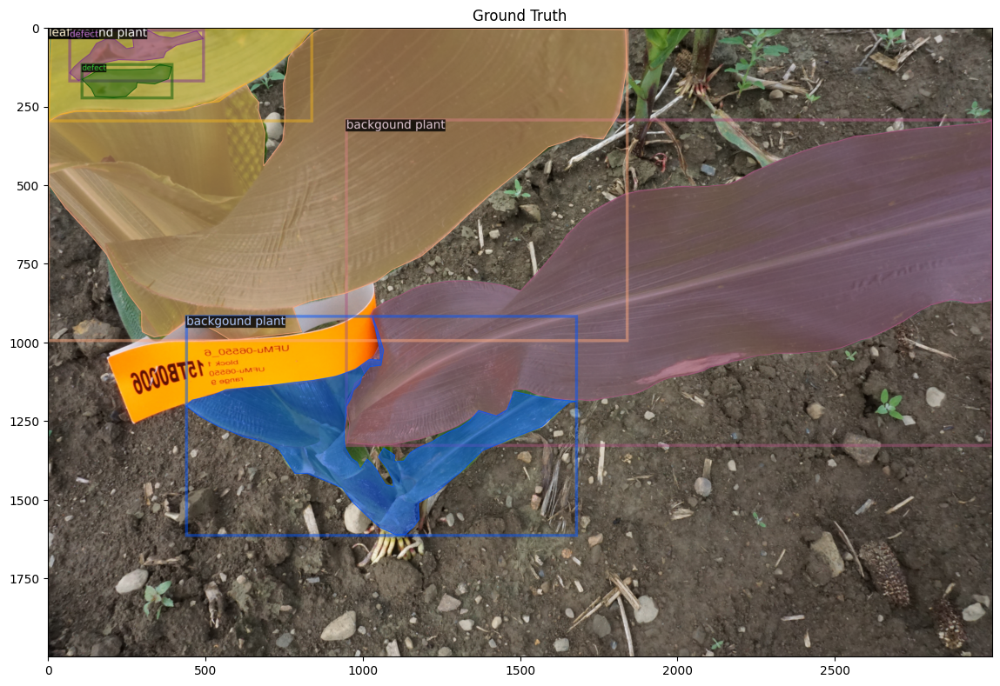

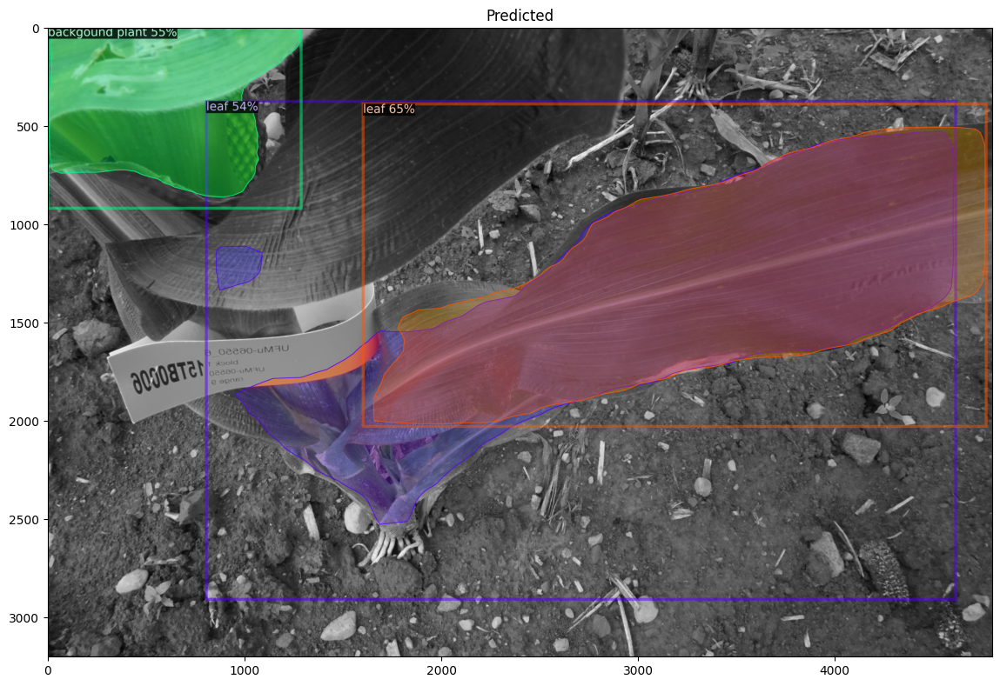

In [27]:
from detectron2.utils.visualizer import ColorMode

def display_image_with_masks(dataset, metadata, predictor, image_filename):
    # Find the index of the image with the given filename in the dataset
    image_index = None
    for idx, d in enumerate(dataset):
        if d["file_name"].endswith(image_filename):
            image_index = idx
            break

    if image_index is None:
        print(f"Image '{image_filename}' not found in the dataset.")
        return

    image_data = dataset[image_index]
    img = cv2.imread(image_data["file_name"])
    if img is None:
        print(f"Unable to read image: {image_data['file_name']}")
        return

    # Display ground truth
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    vis_gt = visualizer.draw_dataset_dict(image_data)
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(vis_gt.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.title("Ground Truth")
    plt.show()

    # Display predicted
    outputs = predictor(img)
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=metadata,
                            scale=0.8,
                            instance_mode=ColorMode.IMAGE_BW)
    vis_pred = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(vis_pred.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.title("Predicted")
    plt.show()

# Assuming you have already defined 'dataset_dicts' and 'leaf_metadata' as in your code
# Also, 'predictor' is your DefaultPredictor as defined in your code

# Display images with masks for "DSC00130_rotated.JPG"
image_filename_to_show = "DSC00124_flip.JPG"
display_image_with_masks(dataset_dicts_T, leaf_metadata, predictor, image_filename_to_show)


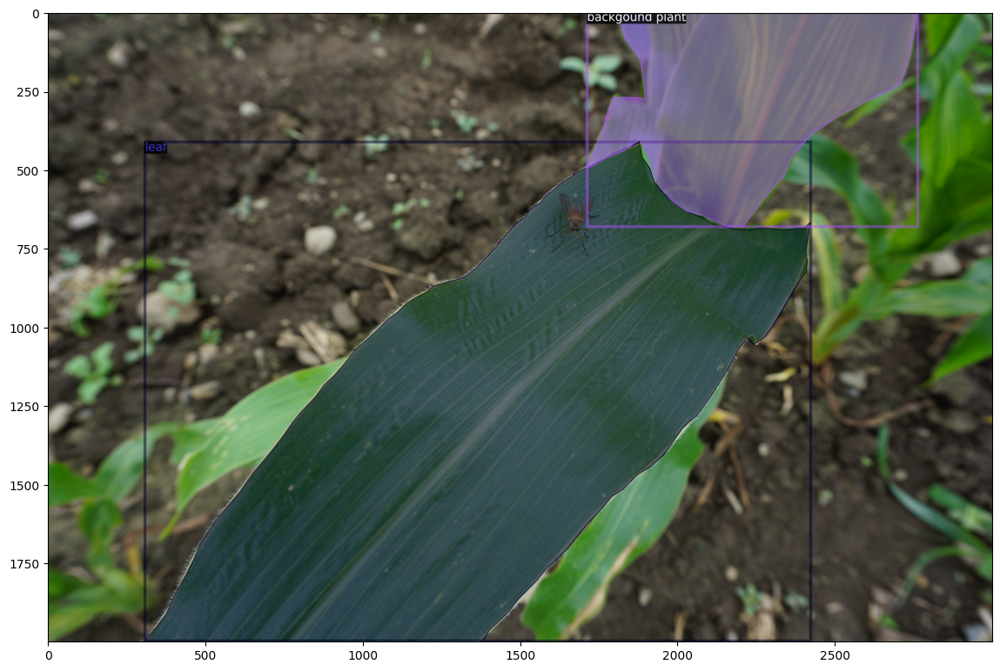

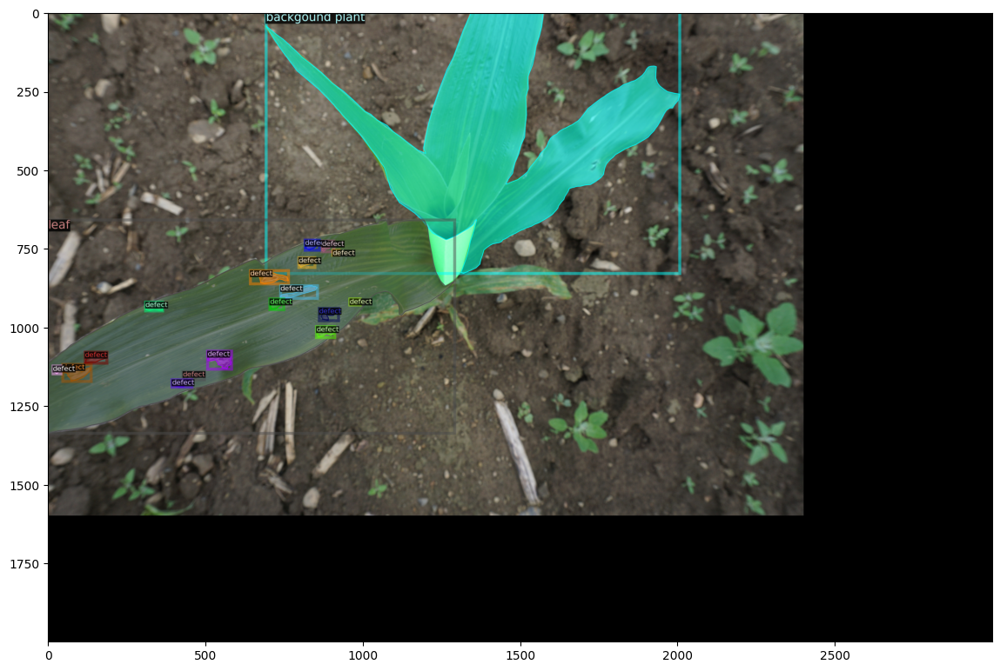

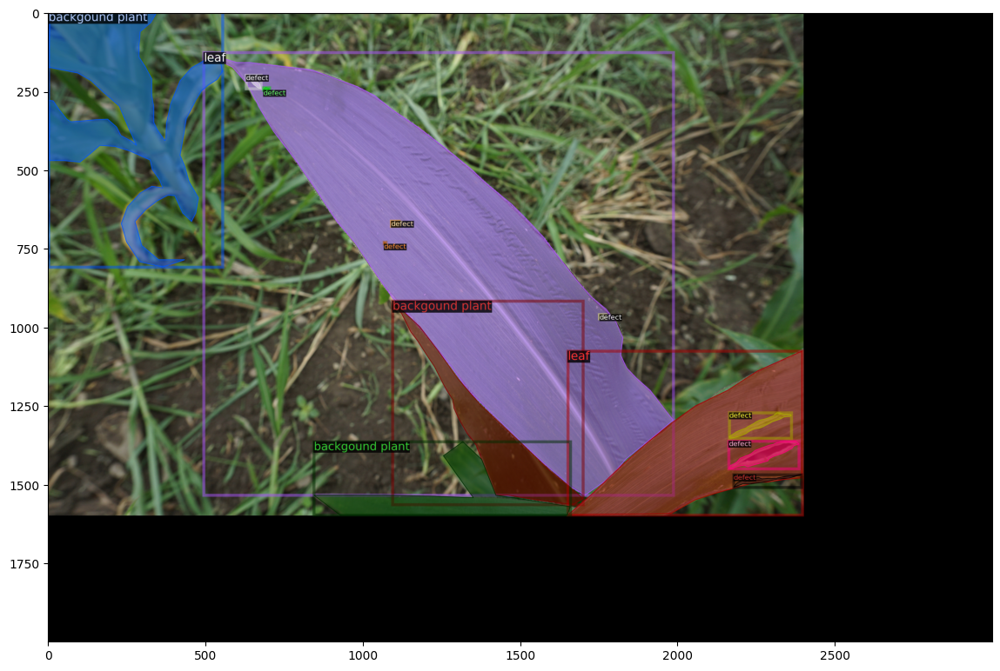

KeyboardInterrupt: 

In [24]:
from detectron2.utils.visualizer import ColorMode

def display_ground_truth_with_mask(dataset, metadata, num_samples=3):
    sample_dicts = random.sample(dataset, num_samples)
    for d in sample_dicts:
        img = cv2.imread(d["file_name"])
        if img is None:
            print(f"Unable to read image: {d['file_name']}")
            continue

        visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
        vis = visualizer.draw_dataset_dict(d)

        plt.figure(figsize=(14, 10))
        plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
        plt.show()

def display_predicted_with_mask(dataset, metadata, predictor, num_samples=3):
    sample_dicts = random.sample(dataset, num_samples)
    for d in sample_dicts:
        im = cv2.imread(d["file_name"])
        if im is None:
            print(f"Unable to read image: {d['file_name']}")
            continue

        outputs = predictor(im)
        visualizer = Visualizer(im[:, :, ::-1],
                                metadata=metadata,
                                scale=0.8,
                                instance_mode=ColorMode.IMAGE_BW)
        vis = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))

        plt.figure(figsize=(14, 10))
        plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
        plt.show()

# Assuming you have already defined 'dataset_dicts' and 'leaf_metadata' as in your code
# Also, 'predictor' is your DefaultPredictor as defined in your code

# Display ground truth images with masks
display_ground_truth_with_mask(dataset_dicts, leaf_metadata, num_samples=3)

# Display predicted images with masks
display_predicted_with_mask(dataset_dicts, leaf_metadata, predictor, num_samples=3)


In [ ]:
import os
import cv2
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from shapely.geometry import Polygon

def calculate_iou(poly1, poly2):
    # Convert polygons to Shapely Polygon objects
    polygon1 = Polygon(poly1)
    polygon2 = Polygon(poly2)
    
    # Calculate intersection area
    intersection_area = polygon1.intersection(polygon2).area
    
    # Calculate union area
    union_area = polygon1.union(polygon2).area
    
    # Calculate IoU
    iou = intersection_area / union_area
    return iou

def extract_defect_coordinates(predictor, image_path):
    img = cv2.imread(image_path)
    outputs = predictor(img)
    pred_defect_instances = outputs["instances"].to("cpu")
    pred_defect_masks = pred_defect_instances.pred_masks

    # Extract the predicted defect coordinates
    pred_defect_coords = []
    for pred_polygon in pred_defect_masks:
        pred_polygon = pred_polygon.squeeze().numpy()
        pred_defect_coords.append(pred_polygon)

    return pred_defect_coords

def main():
    # Load the trained model
    cfg = get_cfg()
    cfg.merge_from_file("path/to/config.yaml")
    cfg.MODEL.WEIGHTS = "path/to/model.pth"
    cfg.MODEL.DEVICE = "cpu"
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4
    predictor = DefaultPredictor(cfg)

    # Specify the path to the test image
    image_path = r'D:\new env for my tesis\all_test\DSC00123_rotated.JPG'

    # Extract defect coordinates from prediction
    pred_defect_coords = extract_defect_coordinates(predictor, image_path)

    # Load the ground truth annotations for the test image
    dataset_dicts_T = DatasetCatalog.get("leaf_all_test")
    for dT in dataset_dicts_T:
        if dT["file_name"] == image_path:
            gt_defect_coords = [obj["segmentation"][0] for obj in dT["annotations"] if obj["category_id"] == 2]
            break

    # Find the intersection of predicted and ground truth defect coordinates
    intersection_coords = []
    for pred_polygon in pred_defect_coords:
        for gt_polygon in gt_defect_coords:
            iou = calculate_iou(pred_polygon, gt_polygon)
            if iou > 0.5:  # Adjust the IoU threshold as needed
                intersection_coords.append(pred_polygon)
                break

    # Visualize the intersection of predicted and ground truth defect coordinates
    img = cv2.imread(image_path)
    v = Visualizer(img[:, :, ::-1], metadata=leaf_metadata, scale=0.8)
    for coord in intersection_coords:
        v.draw_polygon(coord, color='green', edge_color='green', alpha=0.5)
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

if __name__ == "__main__":
    main()
